In [1]:
from config import settings
from hannover_pylon.data import datamodules as dm
from pathlib import Path
from hannover_pylon.modelling.transformation import FromBuffer , CutPSD
import matplotlib.pyplot as plt
from torch import nn 
import pandas as pd 

/home/owilab/Documents/YacineB/Code/hannover-pylon/.venv/lib/python3.10/site-packages/torchdata/datapipes/__init__.py:18: UserWarning: 
################################################################################
WARNING!
The 'datapipes', 'dataloader2' modules are deprecated and will be removed in a
future torchdata release! Please see https://github.com/pytorch/data/issues/1196
to learn more and leave feedback.
################################################################################

  deprecation_warning()


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np

freq_axis = np.linspace(0, 825.5, 8197)
db_path = Path(settings.path.processed,'Welch(n_fft=16392, fs=1651, max_freq=825.5).db')
columns= ['psd']
transform_func = [nn.Sequential(FromBuffer(),CutPSD(freq_axis=freq_axis,freq_range=(0,150)))]
query_key = f'''
    SELECT id FROM data
    WHERE sensor = "accel"
    AND date BETWEEN "{settings.state.healthy_train.start}" AND "{settings.state.healthy_train.end}"
    AND corrupted = 0
'''
data_loader = dm.PSDDataModule(db_path= db_path,columns=columns,transform_func=transform_func, query_key=query_key, batch_size=32, return_dict=False, cached=False)


In [4]:
import pandas as pd 
import sqlite3
conn = sqlite3.connect(db_path)

# Read the 'meteo_data' table into a DataFrame
data_meteo = pd.read_sql('SELECT * FROM meteo_data', conn)
df_plot_meteo = data_meteo.pivot_table(index='date', columns='channel_name', values='value')

# Close the database connection
conn.close()

# Dense AE 

In [5]:
import torch
import torch.nn as nn

class NormLayer(nn.Module):
    def __init__(self, max_val, min_val, denormalize=False):
        super(NormLayer, self).__init__()
        self.register_buffer('max', self._to_tensor(max_val))
        self.register_buffer('min', self._to_tensor(min_val))
        self.denormalize = denormalize
        self.forward_func = {False: self.forward_norm, True: self.forward_denorm}
        self.forward = self.forward_func[self.denormalize]

    def forward_norm(self, x):
        return (x - self.min) / (self.max - self.min + 1e-8)

    def forward_denorm(self, x):
        return x * (self.max - self.min + 1e-8) + self.min

    def _to_tensor(self, val):
        if isinstance(val, torch.Tensor):
            return val.clone().detach()
        else:
            return torch.tensor(val, dtype=torch.float32)
class AutoEncoder(nn.Module):
    def __init__(self, input_size, latent_size):
        super(AutoEncoder, self).__init__()
        self.encoder = nn.Sequential(
            NormLayer(max_val = 4.96, min_val = -5.46, denormalize=False),
            nn.Linear(input_size, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Linear(128, latent_size)
        )
        self.decoder = nn.Sequential(
            nn.Linear(latent_size, 128),
            nn.ReLU(),
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.ReLU(),
            nn.Linear(512, input_size),
            nn.Tanh(),
            NormLayer(max_val = 4.96, min_val = -5.46, denormalize=True))

    def forward(self, x):
        return self.decoder(self.encoder(x))
    
    def encode(self, x):
        return self.encoder(x)
    
import pytorch_lightning as pl
class ReconstructionLoss(pl.LightningModule):
    def __init__(self,input_size, latent_size):
        super(ReconstructionLoss, self).__init__()
        self.input_size = input_size
        self.latent_size = latent_size
        self.model = AutoEncoder(input_size, latent_size)
        self.loss = nn.MSELoss()
        self.save_hyperparameters()
    def forward(self, x):
        x_hat = self.model(x)
        return self.loss(x_hat, x)

    def training_step(self, batch, batch_idx):
        x = batch[0]
        loss = self(x)

        self.log('train_loss', loss,on_epoch=True,prog_bar=True,logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x = batch[0]
        loss = self(x)
        self.log('val_loss', loss,on_epoch=True,prog_bar=True,logger=True)
        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.model.parameters(), lr=1e-3)
        return optimizer

In [7]:
from pytorch_lightning.callbacks import ModelCheckpoint 
from pytorch_lightning.loggers import MLFlowLogger
mlflow = MLFlowLogger(experiment_name='AE',
                      log_model=True,
                      save_dir=settings.path.mlflow[1:])
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, filename='AE-{epoch:02d}-{val_loss:.2f}')

model = ReconstructionLoss(input_size=1490, latent_size=32) 
trainer = pl.Trainer(max_epochs=100, logger=mlflow, callbacks=[checkpoint_callback])
trainer.fit(model, data_loader)



GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA GeForce RTX 4060') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name  | Type        | Params | Mode 
----------------------------------------------
0 | model | AutoEncoder | 1.9 M  | train
1 | loss  | MSELoss     | 0      | train
----------------------------------------------
1.9 M     Trainable params
0         Non-trainable params
1.9 M     Total params
7.460     Total estimated model params size (MB)
21        Modules in train mode
0         Modules in eval mode


Epoch 99: 100%|██████████| 3942/3942 [00:16<00:00, 234.46it/s, v_num=22e5, train_loss_step=0.00727, val_loss=0.00868, train_loss_epoch=0.0086] 

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 99: 100%|██████████| 3942/3942 [00:16<00:00, 234.43it/s, v_num=22e5, train_loss_step=0.00727, val_loss=0.00868, train_loss_epoch=0.0086]


In [ ]:
best_model_pth='/home/owilab/Documents/YacineB/Code/hannover-pylon/lightning_logs/version_108/checkpoints/epoch=9-step=2190.ckpt'

In [8]:
#load best model
best_model_pth =checkpoint_callback.best_model_path
best_model = ReconstructionLoss.load_from_checkpoint(best_model_pth)

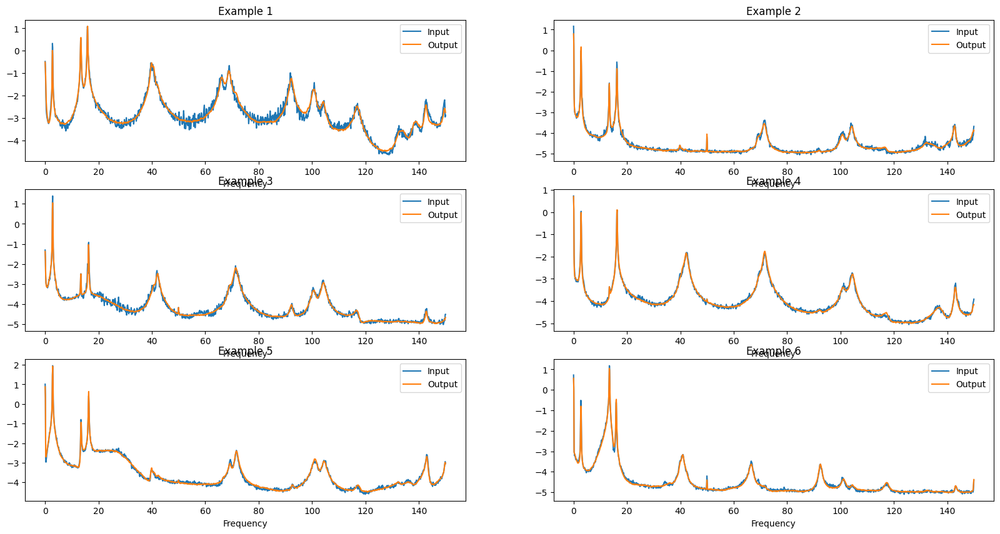

In [9]:
model.eval()
batch = next(iter(data_loader.train_dataloader()))
inputs = batch[0]
with torch.no_grad():
    outputs = model.model(inputs)  # Accessing the AutoEncoder within ReconstructionLoss

# Move tensors to CPU and convert to NumPy arrays
inputs_np = inputs.cpu().numpy()
outputs_np = outputs.cpu().numpy()
fig,ax = plt.subplots(3,2,figsize=(20,10))

for i in range(6):
    ax[i//2,i%2].plot(freq_axis[0:1490],inputs_np[i],label='Input')
    ax[i//2,i%2].plot(freq_axis[0:1490],outputs_np[i],label='Output')
    ax[i//2,i%2].legend()
    ax[i//2,i%2].set_title(f'Example {i+1}')
    ax[i//2,i%2].set_xlabel('Frequency')


In [10]:
# Update columns and transform_func to include 'level' or other labels
columns = ['psd', 'level','direction']  # Add any other labels you want
transform_func = [nn.Sequential(FromBuffer(),CutPSD(freq_axis=freq_axis,freq_range=(0,150))), nn.Identity(), nn.Identity()]  # Add any other transformations you want
dataset = dm.PSDDataset(
    db_path=db_path,
    columns=columns,
    transform_func=transform_func,
    query_key=query_key,
    return_dict=False,
    cached=True
)
psds = torch.stack([d[0] for d in dataset.data])
location = np.array([d[1] for d in dataset.data])
direction = np.array([d[2] for d in dataset.data])
embeddings = model.model.encode(psds).detach().cpu().numpy()


In [11]:
rms = torch.sqrt(torch.mean(psds**2, dim=1))

In [39]:
# upgrade numpy to  most recent version
import umap
reducer = umap.UMAP()
embedding_umap = reducer.fit_transform(embeddings)

/usr/lib/python3.10/importlib/__init__.py:169: UserWarning:

The NumPy module was reloaded (imported a second time). This can in some cases result in small but subtle issues and is discouraged.

[autoreload of numpy.testing._private.utils failed: Traceback (most recent call last):
  File "/home/owilab/Documents/YacineB/Code/hannover-pylon/.venv/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 276, in check
    superreload(m, reload, self.old_objects)
  File "/home/owilab/Documents/YacineB/Code/hannover-pylon/.venv/lib/python3.10/site-packages/IPython/extensions/autoreload.py", line 475, in superreload
    module = reload(module)
  File "/usr/lib/python3.10/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 619, in _exec
  File "<frozen importlib._bootstrap_external>", line 883, in exec_module
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "/home/owilab/Doc

ImportError: Numba needs NumPy 2.0 or less. Got NumPy 2.1.

/tmp/ipykernel_2770141/2848872780.py:22: UserWarning:

Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14

/tmp/ipykernel_2770141/2848872780.py:31: UserWarning:

Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14



ValueError: 'c' argument has 8890 elements, which is inconsistent with 'x' and 'y' with size 157662.

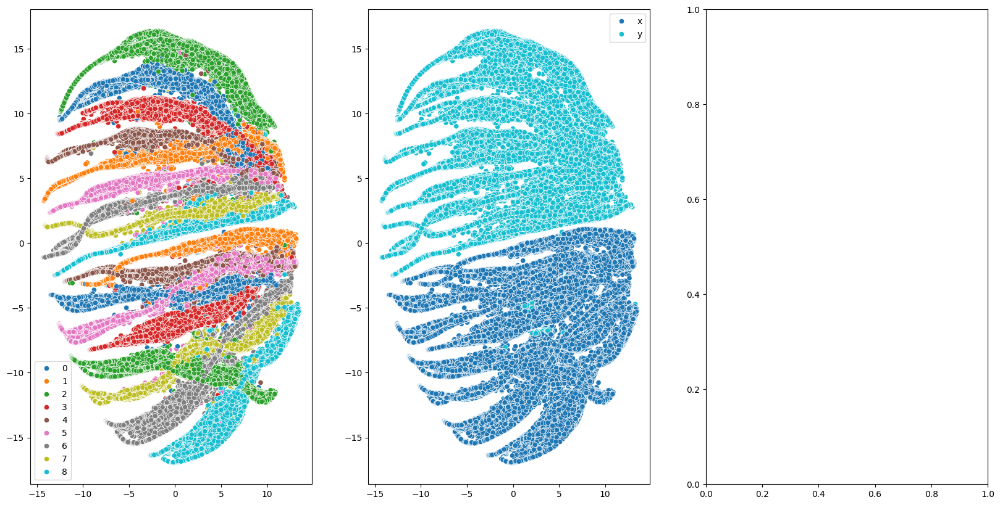

In [35]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.preprocessing import LabelEncoder
import numpy as np
import seaborn as sns

# Define unique categories for location and direction
unique_locations = np.unique(location)
unique_directions = np.unique(direction)

# Use a predefined colormap from matplotlib
location_cmap = plt.get_cmap('tab10', len(unique_locations))  # tab10 for location categories
direction_cmap = plt.get_cmap('tab10', len(unique_directions))  # Blues for direction categories

# Encode categorical variables into numeric values
location_encoded = LabelEncoder().fit_transform(location)
direction_encoded = LabelEncoder().fit_transform(direction)

fig, ax = plt.subplots(1, 3, figsize=(20, 10))

# Plot location-encoded scatter plot
sns.scatterplot(
    x=embedding_umap[:, 0],
    y=embedding_umap[:, 1],
    hue=location_encoded,
    palette=location_cmap.colors,
    ax=ax[0],
)

# Plot direction-encoded scatter plot, with actual labels in the legend
sns.scatterplot(
    x=embedding_umap[:, 0],
    y=embedding_umap[:, 1],
    hue=direction,  # Use the actual direction values instead of encoded ones
    hue_order=np.unique(direction),  # Ensure the order is the same as in the data
    palette=direction_cmap.colors,
    ax=ax[1],
)

# Scatterplot with rms and colorbar
scatter = ax[2].scatter(
    x=embedding_umap[:, 0],
    y=embedding_umap[:, 1],
    c=rms,
    cmap='viridis',  # Choose a colormap for rms values
)
cbar = fig.colorbar(scatter, ax=ax[2])  # Add colorbar to the figure for ax[2]

# Set titles for the subplots
ax[0].set_title('Location Encoded')
ax[1].set_title('Direction with Actual Codes')
ax[2].set_title('RMS Color-Coded')

plt.tight_layout()
plt.show()


In [16]:
import torch
import torch.nn as nn

class Detector(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model
        self.model.eval()
        self.device = next(model.parameters()).device
        
    def mse(self, x):
        with torch.no_grad():
            x_hat = self.model.model(x)
            
    def forward(self, x):
        with torch.no_grad():
            x_hat = self.model(x)
        return torch.quantile((x - x_hat)**2, 0.95, dim=1)
    
class DetectorNiklas(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model
        self.model.eval()
        self.device = next(model.parameters()).device

    def forward(self, x):
        with torch.no_grad():
            x_hat = self.model(x)
            rec_err = x - x_hat

            # Flatten each sample in the batch
            x_flat = x.view(x.size(0), -1)  # shape: (batch_size, num_features)
            rec_err_flat = rec_err.view(x.size(0), -1)

            # Compute mean
            mean_x = x_flat.mean(dim=1, keepdim=True)
            mean_rec_err = rec_err_flat.mean(dim=1, keepdim=True)

            # Subtract mean
            xm = x_flat - mean_x
            rec_errm = rec_err_flat - mean_rec_err

            # Compute covariance and standard deviations
            cov = (xm * rec_errm).mean(dim=1)
            std_x = x_flat.std(dim=1)
            std_rec_err = rec_err_flat.std(dim=1)

            # Avoid division by zero
            eps = 1e-8
            corr_coef = cov / (std_x * std_rec_err + eps)

            # Take absolute value
            corr_coef = torch.abs(corr_coef)

        return corr_coef
        
        
freq_axis = np.linspace(0, 825.5, 8197)
db_path = Path(settings.path.processed,'Welch(n_fft=16392, fs=1651, max_freq=825.5).db')
columns= ['psd']
transform_func = [nn.Sequential(FromBuffer(),CutPSD(freq_axis=freq_axis,freq_range=(0,150)))]
query_key = f'''
    SELECT id FROM data
    WHERE sensor = "accel"
    AND date BETWEEN "{settings.state.healthy_train.start}" AND "{settings.state.healthy_train.end}"
    AND corrupted = 0
'''
data_loader = dm.PSDDataModule(db_path= db_path,columns=columns,transform_func=transform_func, query_key=query_key, batch_size=32, return_dict=False, cached=False)



In [22]:
detector = Detector(model.model) 
#detector = DetectorNiklas(model.model)
db_path = Path(settings.path.processed,'Welch(n_fft=16392, fs=1651, max_freq=825.5).db')
columns= ['psd','date','direction','level']
transform_func = [nn.Sequential(FromBuffer(),CutPSD(freq_axis=freq_axis,freq_range=(0,150))),
                                nn.Identity(),nn.Identity(),nn.Identity()]
query_key = f'''
    SELECT id FROM data
    WHERE sensor = "accel"
    AND corrupted = 0
    AND direction = "y"
'''
data_loader = dm.PSDDataModule(db_path= db_path,columns=columns,transform_func=transform_func, query_key=query_key, batch_size=10240, return_dict=False, cached=False)
data_loader.setup()

df_res = pd.DataFrame(columns=['date', 'mse', 'direction', 'level'])

for batch in data_loader.all_dataloader():
    psds = batch[0]
    dates = batch[1]
    directions = batch[2]
    levels = batch[3]
    mse = detector(psds)
    #for sample with the same date, compute the correlation between the error of sensor 1 and the rest of the sensors

                
    df_temp = pd.DataFrame({'date': dates, 'mse': mse, 'direction': directions, 'level': levels})
    df_res = pd.concat([df_res, df_temp], axis=0)    

/tmp/ipykernel_3081011/589212661.py:28: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_res = pd.concat([df_res, df_temp], axis=0)


In [23]:
events = settings.state.to_dict()

In [24]:
from hannover_pylon.utils.plot import add_events, highlight_severity, create_date_formatter
from hannover_pylon.utils.evaluation import label_dataframe_event, compute_TPR , auc_computation

In [25]:
df_res['date'] = pd.to_datetime(df_res['date'])
df_res_y = df_res[df_res['direction'] == 'y']
df_pivot = df_res_y.pivot_table(index='level', columns=['date'], values='mse', aggfunc='mean')
df_pivot_T = df_pivot.T
# merge with meteo data
# Ensure proper datetime index for both dataframes
# Ensure the index is a datetime column
df_pivot_T.index = pd.to_datetime(df_pivot_T.index)
df_plot_meteo.index = pd.to_datetime(df_plot_meteo.index)

# Reset the index to create 'date' as a column for merging
df_pivot_T_reset = df_pivot_T.reset_index()
df_pivot_T_reset.rename(columns={'index': 'date'}, inplace=True)  # Rename for consistent key
df_plot_meteo_reset = df_plot_meteo.reset_index()

# Perform the asof merge with a 3-minute tolerance
df_pivot_T_merged = pd.merge_asof(
    df_pivot_T_reset,
    df_plot_meteo_reset,
    on='date',  # Use the 'date' column as the key
    direction='nearest',
    tolerance=pd.Timedelta('3min')
)

# Restore the 'date' column as the index
df_pivot_T_merged.set_index('date', inplace=True)

# Display the merged dataframe



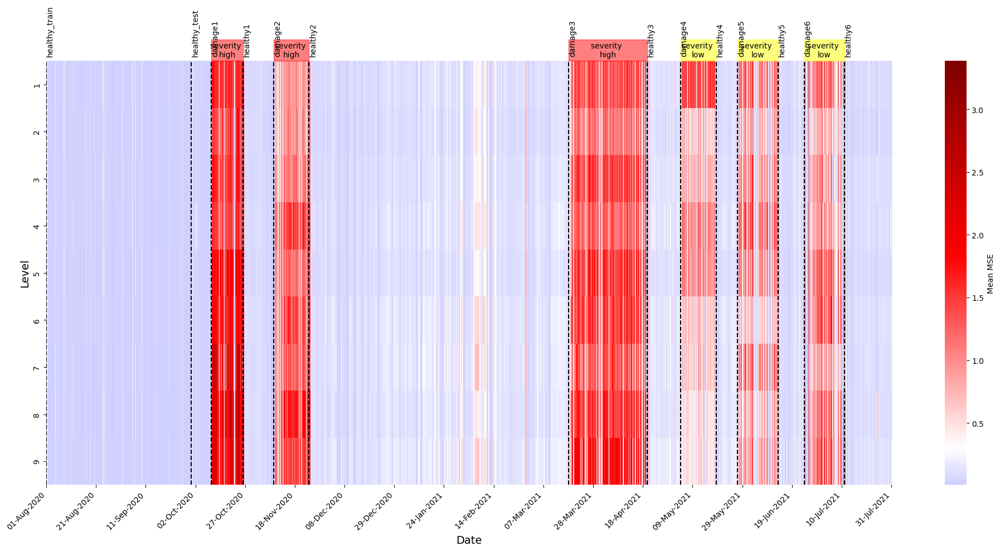

In [30]:
# Ensure the columns are in datetime format for consistency
import seaborn as sns
from matplotlib.ticker import MaxNLocator
df_pivot_T_merged.index = pd.to_datetime(df_pivot_T_merged.index)

# Create the heatmap plot
fig, ax = plt.subplots(figsize=(20, 10))

# Filter rows and plot the heatmap
sns.heatmap(
    df_pivot_T_merged.T.filter(regex="[1-9]$", axis=0),  # Filter rows matching the regex
    cmap='seismic',  # Color map
    cbar_kws={'label': 'Mean MSE'},  # Color bar label
    ax=ax,
    center=0.3
)
# set x-axis values to dates
ax11 = ax
ax.xaxis.set_major_formatter(create_date_formatter(df_pivot_T_merged.index))  # Custom formatter for dates
ax.xaxis.set_major_locator(MaxNLocator(nbins=20))  # Reduce the number of x-axis ticks



# Set axis labels and formatting
ax.set_xlabel('Date', fontsize=14)
ax.set_ylabel('Level', fontsize=14)


# Rotate the x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Add events and highlight severity
add_events(ax, df_pivot.columns, events)
highlight_severity(ax, df_pivot.columns, events)

# Tighten the layout and save the figure
plt.tight_layout()
plt.savefig('ControlChart_AE_PSD_version_1.png')
plt.show()


model performance vs anomaly Index 

accuracy vs anomaly index


In [29]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Ensure the columns are in datetime format
df_pivot_T_merged.index = pd.to_datetime(df_pivot_T_merged.index)
df_pivot = df_pivot_T_merged.T
# Prepare the heatmap data
heatmap_data = df_pivot.filter(regex="[1-9]$", axis=0)

# Create the subplots with secondary y-axis
fig = make_subplots(
    rows=1, cols=1,
    shared_xaxes=True,
    specs=[[{"secondary_y": True}]],
    subplot_titles=["Heatmap and Air Temperature"]
)

# Add the heatmap
fig.add_trace(
    go.Heatmap(
        z=heatmap_data.values,  # Heatmap values
        x=heatmap_data.columns,  # Datetime columns for x-axis
        y=heatmap_data.index,  # Levels for y-axis
        colorscale='RdBu_r',  # Colormap
        colorbar=dict(title="Mean MSE"),
        zmid=0.3,
        zmin = 0,
        zmax=2 
    ),
    row=1, col=1, secondary_y=False
)

# Add the air temperature line plot
fig.add_trace(
    go.Scatter(
        x=df_pivot.columns,  # Datetime x-axis
        y=df_pivot.loc['airTemperatureAt2m'],  # Air temperature values
        mode='lines',
        line=dict(color='black'),
        name='Air Temperature (°C)'  # Legend name
    ),
    row=1, col=1, secondary_y=True
)
fig.add_trace(
    go.Scatter(
        x=df_pivot.columns,  # Datetime x-axis
        y=df_pivot.loc['avgWindSpeedAt10m'],  # Air temperature values
        mode='lines',
        line=dict(color='blue'),
        name='Level'  # Legend name
    ),
        row=1, col=1, secondary_y=True

)

# Update axis labels
fig.update_xaxes(title_text="Date", tickangle=45)
fig.update_yaxes(title_text="Level", secondary_y=False)
fig.update_yaxes(title_text="Air Temperature (°C)", secondary_y=True)

# Update layout
fig.update_layout(
    title="Heatmap and Air Temperature Over Time",
    height=600,
    width=1200,
    template="plotly_white"
)

# Show the plot
fig.show()


In [ ]:
pl

acceleration_sensor = wind speed  <== RMS ? 
wind speed in 5 minutes 
small variance  of sensor 17 - 18  


0.9 a,nd 0.95  0.96 ==> 0.95 

In [50]:
import nbformat
nbformat.__version__

'5.10.4'

Text(0, 0.5, 'Wind Speed (m/s)')

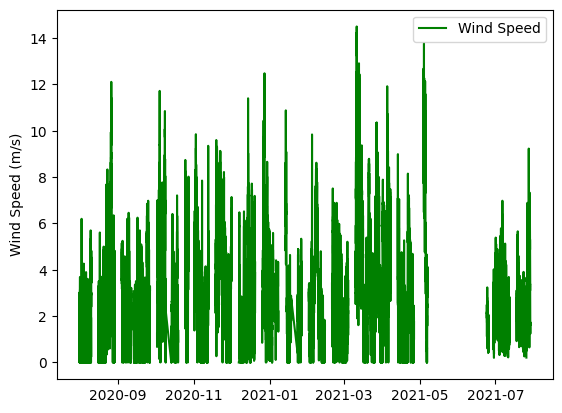

In [43]:
plt.plot(df_pivot_T_merged.index,df_pivot_T_merged['avgWindSpeedAt10m'],'g',label='Wind Speed') 
plt.legend()
plt.ylabel('Wind Speed (m/s)')

In [28]:
label_dataframe_event(df_res, events)

ValueError: 2

# Convolution AE

In [5]:
import torch
import torch.nn as nn
class NormLayer(nn.Module):
    def __init__(self, max_val, min_val, denormalize=False):
        super(NormLayer, self).__init__()
        self.register_buffer('max', self._to_tensor(max_val))
        self.register_buffer('min', self._to_tensor(min_val))
        self.denormalize = denormalize
        self.forward_func = {False: self.forward_norm, True: self.forward_denorm}
        self.forward = self.forward_func[self.denormalize]

    def forward_norm(self, x):
        return (x - self.min) / (self.max - self.min + 1e-8)

    def forward_denorm(self, x):
        return x * (self.max - self.min + 1e-8) + self.min

    def _to_tensor(self, val):
        if isinstance(val, torch.Tensor):
            return val.clone().detach()
        else:
            return torch.tensor(val, dtype=torch.float32)
        
class UnsqueezeLayer(nn.Module):
    def __init__(self, dim=1):
        super(UnsqueezeLayer, self).__init__()
        self.dim = dim

    def forward(self, x):
        x = x.unsqueeze(self.dim)
        return x

class SqueezeLayer(nn.Module):
    def __init__(self, dim=1):
        super(SqueezeLayer, self).__init__()
        self.dim = dim

    def forward(self, x):
        x = x.squeeze(self.dim)
        return x

class AutoEncoderConv(nn.Module):
    def __init__(self,input_size):
        super(AutoEncoderConv, self).__init__()
        
        self.encoder = nn.Sequential(
            NormLayer(max_val = 4.96, min_val = -5.46),
            UnsqueezeLayer(1),
            nn.Conv1d(in_channels=1, out_channels=16, kernel_size=25, stride=5, padding=1),
            nn.BatchNorm1d(16),
            nn.LeakyReLU(),
            nn.Conv1d(in_channels=16, out_channels=64, kernel_size=25, stride=10, padding=1),
            nn.BatchNorm1d(64),
            nn.ReLU(),
            nn.Conv1d(in_channels=64, out_channels=16, kernel_size=30, stride=1, padding=1),
            SqueezeLayer(-1),
        )
        
        self.decoder = nn.Sequential(
            nn.Linear(16, 128),
            nn.LeakyReLU(),
            nn.Linear(128, 512),

            nn.LeakyReLU(),

            nn.Linear(512, input_size),
            NormLayer(max_val = 4.96, min_val = -5.46, denormalize=True)
        )

        # Register buffers for tracking reconstruction errors
        self.register_buffer('rec_err', torch.tensor(0.0))

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x
    
    def forward_embedding(self, x):
        return self.encoder(x)
    
    def update_rec_err(self, rec_err):
        self.rec_err = rec_err
        
import pytorch_lightning as pl
class ReconstructionLoss(pl.LightningModule):
    def __init__(self,input_size):
        super(ReconstructionLoss, self).__init__()
        self.input_size = input_size
        self.model = AutoEncoderConv(input_size)
        self.loss = nn.MSELoss()
        self.save_hyperparameters()
    def forward(self, x):
        x_hat = self.model(x)
        return self.loss(x_hat, x)

    def training_step(self, batch, batch_idx):
        x = batch[0]
        loss = self(x)

        self.log('train_loss', loss,on_epoch=True,prog_bar=True,logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x = batch[0]
        loss = self(x)
        self.log('val_loss', loss,on_epoch=True,prog_bar=True,logger=True)
        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.model.parameters(), lr=1e-3)
        return optimizer
    

In [6]:
import numpy as np

freq_axis = np.linspace(0, 825.5, 8197)
db_path = Path(settings.path.processed,'Welch(n_fft=16392, fs=1651, max_freq=825.5).db')
columns= ['psd']
transform_func = [nn.Sequential(FromBuffer(),CutPSD(freq_axis=freq_axis,freq_range=(0,150)))]
query_key = f'''
    SELECT id FROM data
    WHERE sensor = "accel"
    AND date BETWEEN "{settings.state.healthy_train.start}" AND "{settings.state.healthy_train.end}"
    AND corrupted = 0
'''
data_loader = dm.PSDDataModule(db_path= db_path,columns=columns,transform_func=transform_func, query_key=query_key, batch_size=32, return_dict=False, cached=False)


In [7]:
# free up all gpu memory
import torch, gc
torch.set_float32_matmul_precision("medium")
gc.collect()
print('Memory allocated:', torch.cuda.memory_allocated())
print('Memory cached:', torch.cuda.memory_reserved())
torch.cuda.empty_cache()
print('Memory allocated:', torch.cuda.memory_allocated())
print('Memory cached:', torch.cuda.memory_reserved())


Memory allocated: 0
Memory cached: 0
Memory allocated: 0
Memory cached: 0


In [8]:
from pytorch_lightning.callbacks import ModelCheckpoint 
from pytorch_lightning.loggers import MLFlowLogger
mlflow = MLFlowLogger(experiment_name='AE',
                      log_model=True,
                      save_dir=settings.path.mlflow[1:])
checkpoint_callback = ModelCheckpoint(monitor='val_loss', save_top_k=1, filename='CAE-{epoch:02d}-{val_loss:.2f}')

model = ReconstructionLoss(input_size=1490) 
trainer = pl.Trainer(max_epochs=20, logger=mlflow, callbacks=[checkpoint_callback])
trainer.fit(model, data_loader)



GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name  | Type            | Params | Mode 
--------------------------------------------------
0 | model | AutoEncoderConv | 889 K  | train
1 | loss  | MSELoss         | 0      | train
--------------------------------------------------
889 K     Trainable params
0         Non-trainable params
889 K     Total params
3.558     Total estimated model params size (MB)
20        Modules in train mode
0         Modules in eval mode


Epoch 19: 100%|██████████| 3942/3942 [00:17<00:00, 225.68it/s, v_num=65b9, train_loss_step=0.0133, val_loss=0.0111, train_loss_epoch=0.00999] 

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 19: 100%|██████████| 3942/3942 [00:17<00:00, 225.65it/s, v_num=65b9, train_loss_step=0.0133, val_loss=0.0111, train_loss_epoch=0.00999]


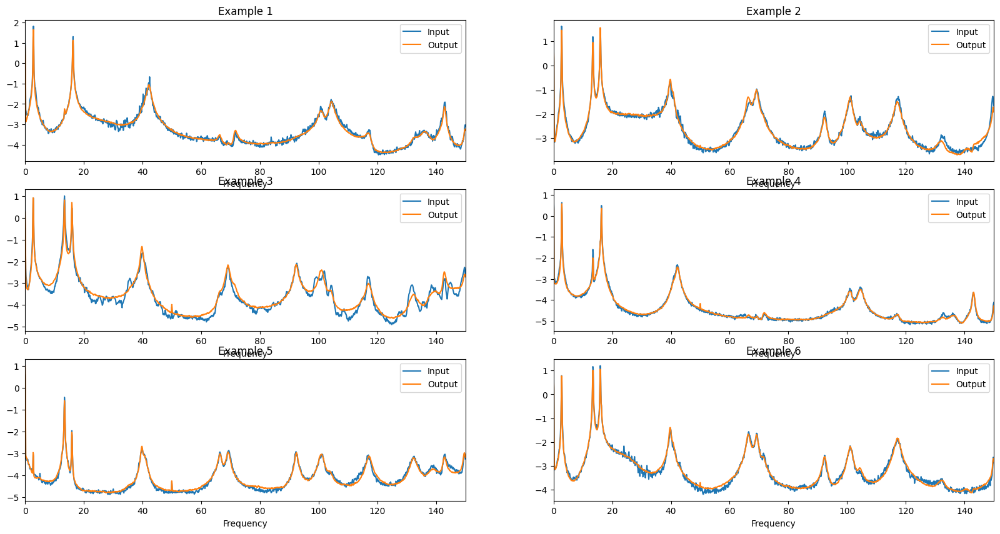

In [9]:
model.eval()
batch = next(iter(data_loader.val_dataloader()))
inputs = batch[0]
with torch.no_grad():
    outputs = model.model(inputs)  # Accessing the AutoEncoder within ReconstructionLoss

# Move tensors to CPU and convert to NumPy arrays
inputs_np = inputs.cpu().numpy()
outputs_np = outputs.cpu().numpy()
fig,ax = plt.subplots(3,2,figsize=(20,10))

for i in range(6):
    ax[i//2,i%2].plot(freq_axis[0:1490],inputs_np[i],label='Input')
    ax[i//2,i%2].plot(freq_axis[0:1490],outputs_np[i],label='Output')
    ax[i//2,i%2].legend()
    ax[i//2,i%2].set_title(f'Example {i+1}')
    ax[i//2,i%2].set_xlabel('Frequency')
    ax[i//2,i%2].set_xlim(0,150)


In [ ]:
import torch
import torch.nn as nn
from collections import defaultdict

class Detector(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model
        self.model.eval()
        # a default dict , label in tuple form and values set to +inf
        self.min_dict = defaultdict(lambda: float('inf'))
        self.max_dict = defaultdict(lambda: float('-inf'))
        self.device = next(model.parameters()).device
        
    def mse(self, x):
        with torch.no_grad():
            x_hat = self.model(x)
            loss = torch.quantile((x - x_hat) ** 2,q=0.9, dim=-1)
        return loss

    def forward(self, x,):
        return self.mse(x)

In [11]:
import torch
import numpy as np

# Update columns and transform_func to include 'level' or other labels
columns = ['psd', 'level', 'direction']  # Add any other labels you want
transform_func = [
    nn.Sequential(FromBuffer(), CutPSD(freq_axis=freq_axis, freq_range=(0, 150))),
    nn.Identity(),
    nn.Identity()
]  
query_key = f'''
    SELECT id FROM data
    WHERE sensor = "accel"
    AND date BETWEEN "{settings.state.healthy_train.start}" AND "{settings.state.healthy_train.end}"
    AND corrupted = 0
'''

# Ensure the model is in evaluation mode
model.eval()

# Set up the data loader for testing
data_loader_test = dm.PSDDataModule(
    db_path=db_path,
    columns=columns,
    transform_func=transform_func,
    query_key=query_key,
    batch_size=32,
    return_dict=True,
    cached=False
)
data_loader_test.setup()

# Prepare lists to store results
embeddings = []
level_labels = []
direction_labels = []
rms_values = []

# Loop through batches and process data
for batch in data_loader_test.val_dataloader():
    x = batch['psd'].to(model.device)
    
    # Improved RMS calculation: detach and use torch operations for consistency
    rms_batch = torch.sqrt(torch.mean(x**2, dim=-1)).detach().cpu().numpy()
    rms_values.extend(rms_batch)
    
    # Extract and store embeddings
    with torch.no_grad():  # Ensure gradients are not computed
        embeddings_batch = model.model.encoder(x).cpu().numpy()
    embeddings.append(embeddings_batch)
    
    # Store labels
    level_labels.append(batch['level'].cpu().numpy())
    direction_labels.append(batch['direction'])

# Concatenate results for final output
embeddings = np.concatenate(embeddings, axis=0)
level_labels = np.concatenate(level_labels, axis=0)
direction_labels = np.concatenate(direction_labels, axis=0)



In [12]:
rms_values

[np.float32(2.80142),
 np.float32(2.8661044),
 np.float32(4.709059),
 np.float32(4.7394),
 np.float32(3.2915065),
 np.float32(4.8789163),
 np.float32(3.7533503),
 np.float32(3.427795),
 np.float32(3.6810813),
 np.float32(4.855904),
 np.float32(4.841768),
 np.float32(4.0357704),
 np.float32(3.977626),
 np.float32(3.8972824),
 np.float32(4.532245),
 np.float32(4.5109863),
 np.float32(0.7732296),
 np.float32(4.6656895),
 np.float32(4.0751677),
 np.float32(4.8174124),
 np.float32(3.2184563),
 np.float32(4.8097878),
 np.float32(4.8773675),
 np.float32(4.5780597),
 np.float32(4.630415),
 np.float32(4.6894636),
 np.float32(4.11998),
 np.float32(3.7831528),
 np.float32(4.7572784),
 np.float32(4.6293745),
 np.float32(3.9166687),
 np.float32(3.1400125),
 np.float32(3.8201098),
 np.float32(4.2318935),
 np.float32(4.4808655),
 np.float32(3.3288682),
 np.float32(3.6284077),
 np.float32(2.5215733),
 np.float32(3.1616638),
 np.float32(2.7076237),
 np.float32(3.5949643),
 np.float32(4.806656),
 np.flo

In [13]:
import umap
reducer = umap.UMAP()
embedding_umap = reducer.fit_transform(embeddings)

/home/owilab/Documents/YacineB/Code/hannover-pylon/.venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


/tmp/ipykernel_3075643/1344028189.py:22: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  sns.scatterplot(
/tmp/ipykernel_3075643/1344028189.py:31: UserWarning: Numpy array is not a supported type for `palette`. Please convert your palette to a list. This will become an error in v0.14
  sns.scatterplot(


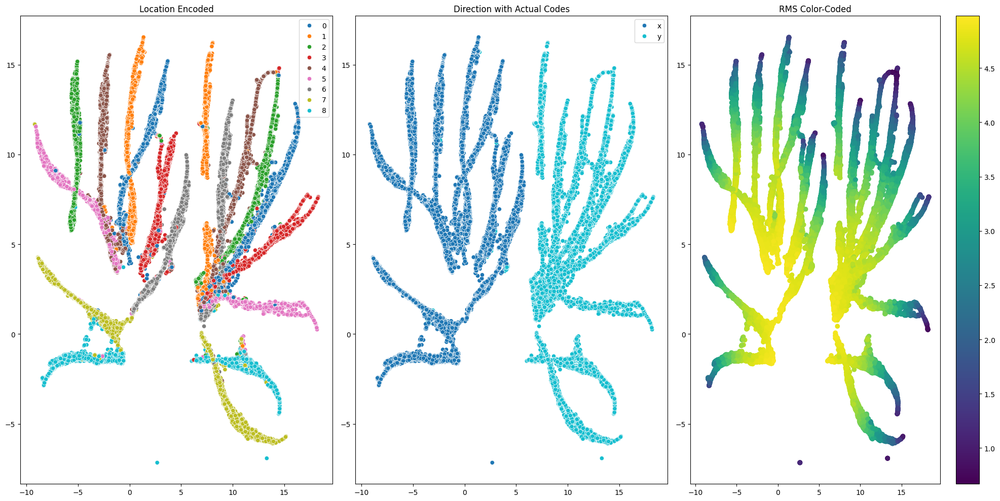

In [14]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.preprocessing import LabelEncoder
import numpy as np
import seaborn as sns

# Define unique categories for location and direction
unique_locations = np.unique(level_labels)
unique_directions = np.unique(direction_labels)

# Use a predefined colormap from matplotlib
location_cmap = plt.get_cmap('tab10', len(unique_locations))  # tab10 for location categories
direction_cmap = plt.get_cmap('tab10', len(unique_directions))  # Blues for direction categories

# Encode categorical variables into numeric values
location_encoded = LabelEncoder().fit_transform(level_labels)
direction_encoded = LabelEncoder().fit_transform(direction_labels)

fig, ax = plt.subplots(1, 3, figsize=(20, 10))

# Plot location-encoded scatter plot
sns.scatterplot(
    x=embedding_umap[:, 0],
    y=embedding_umap[:, 1],
    hue=location_encoded,
    palette=location_cmap.colors,
    ax=ax[0],
)

# Plot direction-encoded scatter plot, with actual labels in the legend
sns.scatterplot(
    x=embedding_umap[:, 0],
    y=embedding_umap[:, 1],
    hue=direction_labels,  # Use the actual direction values instead of encoded ones
    hue_order=np.unique(direction_labels),  # Ensure the order is the same as in the data
    palette=direction_cmap.colors,
    ax=ax[1],
)

# Scatterplot with rms and colorbar
scatter = ax[2].scatter(
    x=embedding_umap[:, 0],
    y=embedding_umap[:, 1],
    c=rms_values,
    cmap='viridis',  # Choose a colormap for rms values
)
cbar = fig.colorbar(scatter, ax=ax[2])  # Add colorbar to the figure for ax[2]

# Set titles for the subplots
ax[0].set_title('Location Encoded')
ax[1].set_title('Direction with Actual Codes')
ax[2].set_title('RMS Color-Coded')

plt.tight_layout()
plt.show()


In [15]:
import pandas as pd
detector = Detector(model.model) 
db_path = Path(settings.path.processed,'Welch(n_fft=16392, fs=1651, max_freq=825.5).db')
columns= ['psd','date','direction','level']
transform_func = [nn.Sequential(FromBuffer(),CutPSD(freq_axis=freq_axis,freq_range=(0,150))),nn.Identity(),nn.Identity(),nn.Identity()]
query_key = f'''
    SELECT id FROM data
    WHERE sensor = "accel"
    AND corrupted = 0
'''
data_loader = dm.PSDDataModule(db_path= db_path,columns=columns,transform_func=transform_func, query_key=query_key, batch_size=5000, return_dict=False, cached=False)
data_loader.setup()

df_res = pd.DataFrame(columns=['date', 'mse', 'direction', 'level'])

for batch in data_loader.all_dataloader():
    psds = batch[0]
    dates = batch[1]
    directions = batch[2]
    levels = batch[3]
    mse = detector(psds)
    df_temp = pd.DataFrame({'date': dates, 'mse': mse, 'direction': directions, 'level': levels})
    df_res = pd.concat([df_res, df_temp], axis=0)    

/tmp/ipykernel_3075643/1646381635.py:23: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_res = pd.concat([df_res, df_temp], axis=0)


In [16]:
events = settings.state.to_dict()

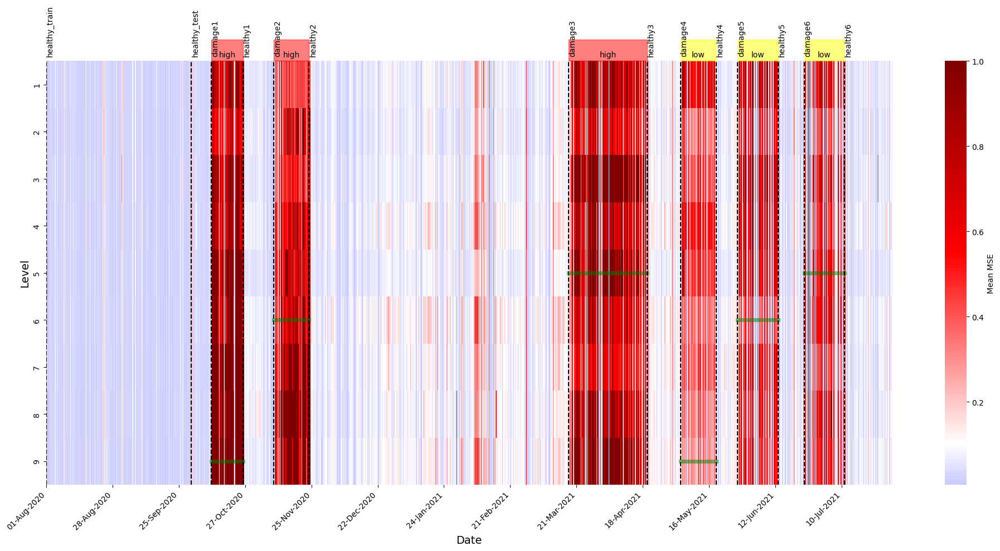

In [ ]:
from matplotlib.ticker import FuncFormatter

def create_date_formatter(column_dates):
    """Return a custom formatter function for datetime labels."""
    def custom_date_format(x, pos=None):
        if 0 <= int(x) < len(column_dates):
            return column_dates[int(x)].strftime('%d-%b-%Y')
        return ''  # Return empty string if out of range
    return FuncFormatter(custom_date_format)Votre position

# Apply the custom date formatter

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter, MaxNLocator
from matplotlib.patches import Rectangle
import pandas as pd
import numpy as np
from functools import partial

# Filter the dataframe for 'y' direction and pivot the data for the heatmap
df_res['date'] = pd.to_datetime(df_res['date'])
df_res_y = df_res[df_res['direction'] == 'y']
df_pivot = df_res_y.pivot_table(index='level', columns=['date'], values='mse', aggfunc='mean')
# average the mse over 1hours rolling window with 1 hour step
fig, ax = plt.subplots(1, 1, figsize=(20, 10))

# Plot the heatmap with seaborn
df_pivot.columns = pd.to_datetime(df_pivot.columns)

sns.heatmap(
    df_pivot, 
    cmap='seismic',  # Set the color map to 'seismic' for highlighting extremes
    cbar_kws={'label': 'Mean MSE'},  # Add a color bar label
    ax=ax,
    center=0.1,
    vmax=1
)
# Set axis labels and title
ax.set_xlabel('Date', fontsize=14)
ax.set_ylabel('Level', fontsize=14)
ax.xaxis.set_major_formatter(create_date_formatter(df_pivot.columns))
ax.xaxis.set_major_locator(MaxNLocator(nbins=15))  # Set the maximum number of ticks

# Rotate the x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

for event_i in events:
    start = pd.to_datetime(events[event_i]['start'])
    end = pd.to_datetime(events[event_i]['end'])
    idx_start = np.cumsum(df_pivot.columns < start)[-1]
    idx_end = np.cumsum(df_pivot.columns < end)[-1]
    
    # Draw vertical line and label for event
    ax.axvline(idx_start, color='black', linestyle='--', label=f'{event_i} start')
    ax.text(idx_start, -0.1, f'{event_i}', rotation=90, va='bottom', ha='left')
    
    # Draw horizontal line for the closest sensor level during the event
    level = events[event_i].get('closest_sensor', None)
    if level is not None:
        ax.axhline(level - 0.5, xmin=idx_start / len(df_pivot.columns), xmax=idx_end / len(df_pivot.columns), 
                   color='green', linestyle='-', lw=5, alpha=0.5)
    
    # Draw a box above the plot to indicate severity
    severity = events[event_i].get('severity', None)
    if severity is not None:
        color = 'red' if severity == 'high' else 'yellow'
        # Add rectangle patch above the plot to indicate severity
        box_height = 0.05  # Height of the box
        ax.add_patch(Rectangle(
            (idx_start, 1),  # Starting point of the box (above the plot)
            width=idx_end - idx_start,                # Width of the box
            height=box_height,                        # Height of the box
            color=color, 
            alpha=0.5,
            transform=ax.get_xaxis_transform(),       # Transform to place above the x-axis
            clip_on=False                             # Make sure the rectangle is not clipped
        ))
        ax.text((idx_start + idx_end) / 2, -0.1+ box_height, severity, ha='center', va='bottom', color='black')
# Tighten the layout
plt.tight_layout()

# Show the plot
plt.show()


In [177]:
df_res['label']=label_dataframe_event(df_res['date'],events)

/home/owilab/Documents/YacineB/Code/hannover-pylon/hannover_pylon/evaluation/utils.py:50: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'healthy_train' has dtype incompatible with datetime64[ns], please explicitly cast to a compatible dtype first.
  labels.loc[mask] = event_name


In [178]:
df_pivot = df_res.pivot_table(index='date',
                              columns=['direction', 'level'],
                              values='mse').reset_index()

# Flatten the MultiIndex columns
df_pivot.columns = [
    '_'.join([str(col) for col in column if col != 'date']) if column != 'date' else 'date'
    for column in df_pivot.columns
]


df_pivot.rename(columns={'': 'date'}, inplace=True)
df_pivot['label'] = label_dataframe_event(df_pivot['date'], events)

/home/owilab/Documents/YacineB/Code/hannover-pylon/hannover_pylon/evaluation/utils.py:50: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'healthy_train' has dtype incompatible with datetime64[ns], please explicitly cast to a compatible dtype first.
  labels.loc[mask] = event_name


In [179]:
from sklearn.covariance import OAS
md = OAS()
md= md.fit(df_pivot.query('label == "healthy_train"').filter(regex='[a-z]_'))
df_pivot['mahalanobis'] = md.mahalanobis(df_pivot.filter(regex='[a-z]_'))


In [180]:


threshold = df_pivot.query('label == "healthy_train"')['mahalanobis'].quantile(0.999)
df_pivot.groupby(['label']).apply(lambda x: compute_TPR(x['mahalanobis'].values, threshold))

/tmp/ipykernel_3075643/3846486056.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_pivot.groupby(['label']).apply(lambda x: compute_TPR(x['mahalanobis'].values, threshold))


label
damage1          0.963931
damage2          0.907728
damage3          0.876267
damage4          0.786741
damage5          0.667623
damage6          0.615669
healthy1         0.046537
healthy2         0.048203
healthy3         0.068024
healthy4         0.009266
healthy5         0.039415
healthy6         0.035094
healthy_test     0.000833
healthy_train    0.001028
dtype: float64

In [207]:
min_md, max_md = df_pivot.query('label == "healthy_train"')['mahalanobis'].quantile(0.001), df_pivot.query('label == "healthy_train"')['mahalanobis'].quantile(0.999)
df_pivot['mahalanobis'] = (df_pivot['mahalanobis'] - min_md) / (max_md - min_md)
threshold = df_pivot.query('label == "healthy_train"')['mahalanobis'].quantile(0.999)
df_pivot['group_label'] = df_pivot['label'].apply(lambda x: 'healthy' if x.startswith('healthy') else x)
score = df_pivot.groupby(['label']).apply(lambda x: np.median(x['mahalanobis'].values)) 
score = score / score['healthy_train']
order_of_states = list(settings.state.to_dict().keys())
# reorder the score according to the order of the states
score = score.loc[order_of_states]
score

/tmp/ipykernel_3075643/2519269049.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  score = df_pivot.groupby(['label']).apply(lambda x: np.median(x['mahalanobis'].values))


label
healthy_train         1.000000
healthy_test          1.710787
damage1          189151.998211
healthy1             14.065725
damage2           41021.842856
healthy2             40.863144
damage3           10169.006993
healthy3             38.425176
damage4             847.543248
healthy4             40.790436
damage5            1250.613132
healthy5             17.279885
damage6             725.416699
healthy6             20.708342
dtype: float64

In [205]:
order_of_states = list(settings.state.to_dict().keys())
# reorder the score according to the order of the states
score = score.loc[order_of_states]
# compute the ratio between consecutive states
ratio = score.pct_change()
ratio

label
healthy_train              NaN
healthy_test          0.710787
damage1          110563.291652
healthy1             -0.999926
damage2            2915.439889
healthy2             -0.999004
damage3             247.855227
healthy3             -0.996221
damage4              21.056977
healthy4             -0.951872
damage5              29.659470
healthy5             -0.986183
damage6              40.980414
healthy6             -0.971453
dtype: float64

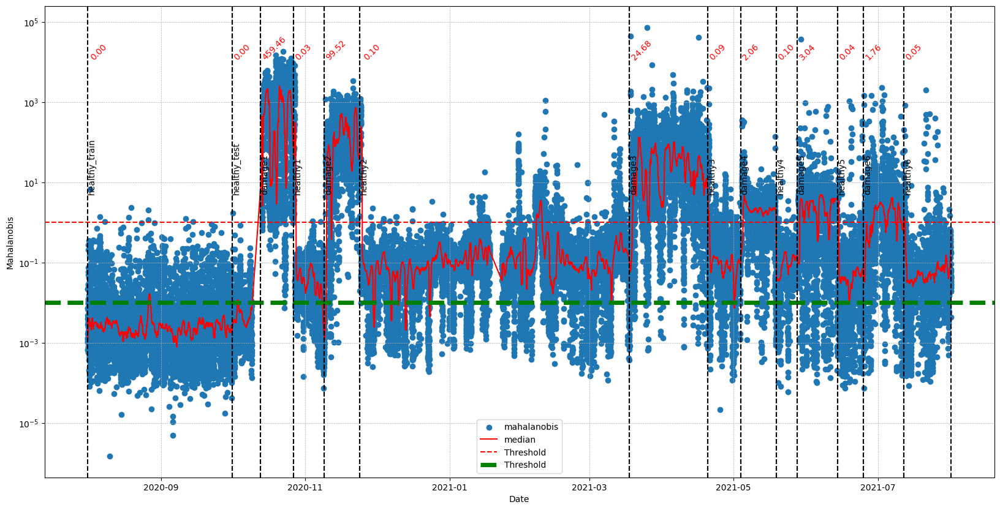

In [191]:
fig , ax = plt.subplots(1,1,figsize=(20,10))
df_pivot['date'] = pd.to_datetime(df_pivot['date'])
df_pivot.index = df_pivot['date']
ax.scatter(df_pivot['date'],df_pivot['mahalanobis'],label='mahalanobis')
# plot a moving average of the mahalanobis score 
ax.plot(df_pivot['date'],df_pivot['mahalanobis'].rolling('1D').median(),label='median',color='red')
ax.axhline(threshold, color='red', linestyle='--', label='Threshold')
ax.axhline(1e-2, color='green', linestyle='--', label='Threshold',lw=5)

ax.set_xlabel('Date')
ax.set_ylabel('Mahalanobis')
ax.legend()
ax.grid(which='both', linestyle='--', linewidth=0.5)
ax.set_yscale('log')
for event_i in events:
    start = pd.to_datetime(events[event_i]['start'])
    end = pd.to_datetime(events[event_i]['end'])
    ax.axvline(start, color='black', linestyle='--', label=f'{event_i} start')
    ax.axvline(end, color='black', linestyle='--', label=f'{event_i} end')
    ax.text(start, 5, f'{event_i}', rotation=90, va='bottom', ha='left')
    # compute the mean of the mahalanobis score during the event
    mask = (df_pivot['date'] >= start) & (df_pivot['date'] <= end)
    mid_point = (end - start) / 100 + start 
    mean = df_pivot.loc[mask, 'mahalanobis'].median()
    ax.text(mid_point, 10000, f'{mean:.2f}', rotation=45, va='bottom', ha='left', color='red') 

In [184]:
df_row = df_res.query("direction == 'y' and level == 1")
reference = df_row.query("label == 'healthy_test' ")
reference_data = reference['mse'].values
partial_auc = partial(auc_computation,reference_data)
df_row.groupby(['label']).apply(lambda x: partial_auc(x['mse'].values))

/tmp/ipykernel_3075643/1096168990.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_row.groupby(['label']).apply(lambda x: partial_auc(x['mse'].values))


label
damage1          0.999397
damage2          0.979153
damage3          0.984391
damage4          0.984731
damage5          0.933405
damage6          0.935971
healthy1         0.822380
healthy2         0.867438
healthy3         0.901312
healthy4         0.908642
healthy5         0.781381
healthy6         0.852794
healthy_test     0.500000
healthy_train    0.346714
dtype: float64

In [ ]:
import re

pattern_healthy = re.compile(r'healthy')
pattern_dmg = re.compile(r'damage')

# Extract states that match the pattern
healthy_states = [state for state in events.keys() if pattern_healthy.search(state) and 'train' not in state] 
# remove train states
damage_state = [state for state in events.keys() if pattern_dmg.search(state)]

In [186]:
# compute the AUC for each state and the healthy state 
df_row = df_res.query("direction == 'y' and level == 3")
# query all the healthy states
reference = df_row.query("label in @healthy_states")
reference_data = reference['mse'].values
partial_auc = partial(auc_computation,reference_data)
df_row.groupby(['label']).apply(lambda x: partial_auc(x['mse'].values))[:6]

/tmp/ipykernel_3075643/1330796986.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_row.groupby(['label']).apply(lambda x: partial_auc(x['mse'].values))[:6]


label
damage1    0.980824
damage2    0.941476
damage3    0.949584
damage4    0.921619
damage5    0.833966
damage6    0.817450
dtype: float64